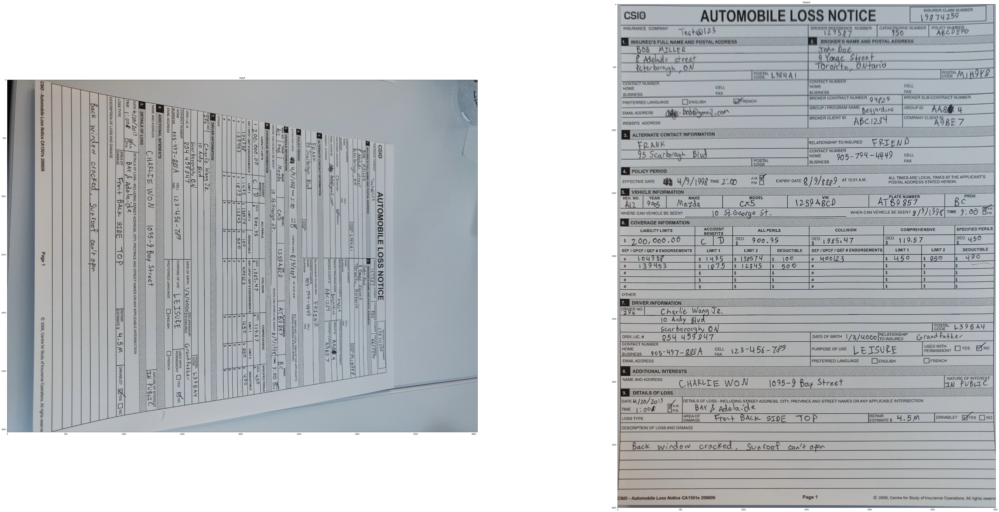

<Figure size 12960x11520 with 0 Axes>

In [9]:
'''
    This script takes a perspective image and 
'''

import numpy as np
import cv2
import matplotlib.pyplot as plt

#img = cv2.imread('img1.jpg')
img = cv2.imread('img2.jpg')

rows,cols,ch = img.shape

# Image 1 regular
#pts1= np.float32([[550,715], [2640,725],[0, 3775],[3024,3800]])
# Image 2 rotated right
pts1 = np.float32([[3242, 535],[3250, 2520], [214,0],[213,3024]])


pts2 = np.float32([[0,0],[3000,0],[0,4000],[3000,4000]])

M = cv2.getPerspectiveTransform(pts1, pts2)

dst = cv2.warpPerspective(img, M, (3000,4000))

plt.subplot(121),plt.imshow(img),plt.title('Input')
plt.subplot(122),plt.imshow(dst),plt.title('Output')

plt.rcParams['figure.figsize'] = [200, 50]
fig=plt.figure(figsize=(180, 160))


In [2]:
import numpy as np
import cv2 as cv
filename = 'Scanned Auto FNOL-2.jpg'
img = cv.imread(filename)
img = cv.fastNlMeansDenoisingColored(img,None,10,10,7,21)
gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
gray = np.float32(gray)
#dst = cv2.Canny(gray,100,200)

dst = cv.cornerHarris(gray,2,3,0.04)
#result is dilated for marking the corners, not important
dst = cv.dilate(dst,None)
# Threshold for an optimal value, it may vary depending on the image.
img[dst>0.01*dst.max()]=[0,0,255]
cv.imwrite('sample.png',img)
cv.imshow('dst',img)
if cv.waitKey(0) & 0xff == 27:
    cv.destroyAllWindows()

error: OpenCV(4.1.0) /Users/travis/build/skvark/opencv-python/opencv/modules/imgproc/src/canny.cpp:949: error: (-215:Assertion failed) _src.depth() == CV_8U in function 'Canny'


In [1]:
import numpy as np
import cv2 as cv
filename = 'Scanned Auto FNOL-2.jpg'
img = cv.imread(filename)
gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
# find Harris corners
gray = np.float32(gray)
dst = cv.cornerHarris(gray,2,3,0.04)
dst = cv.dilate(dst,None)
ret, dst = cv.threshold(dst,0.01*dst.max(),255,0)
dst = np.uint8(dst)
# find centroids
ret, labels, stats, centroids = cv.connectedComponentsWithStats(dst)
# define the criteria to stop and refine the corners
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners = cv.cornerSubPix(gray,np.float32(centroids),(5,5),(-1,-1),criteria)
# Now draw them
res = np.hstack((centroids,corners))
res = np.int0(res)
img[res[:,1],res[:,0]]=[0,0,255]
img[res[:,3],res[:,2]] = [0,255,0]
cv.imwrite('subpixel5.png',img)

True

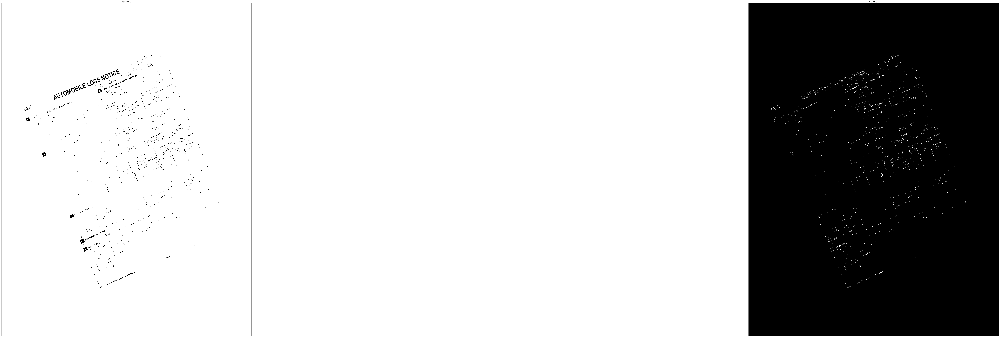

<Figure size 12960x11520 with 0 Axes>

In [5]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image

#opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)

imjpg = Image.open('2.jpg')
imjpg.save('Scanned Auto FNOL-2.png')


img = cv2.imread('Scanned Auto FNOL-2.png')
img = cv2.fastNlMeansDenoisingColored(img,None,10,10,7,21)
#img = cv2.morphologyEx(img, cv2.MORPH_OPEN, None)
img = cv2.morphologyEx(img, cv2.MORPH_CLOSE, None)
img = cv2.morphologyEx(img, cv2.MORPH_OPEN, None)

img_grey = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
(thresh, img) = cv2.threshold(img_grey, 128, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
thresh = 100
img = cv2.threshold(img_grey, thresh, 255, cv2.THRESH_BINARY)[1]
cv2.imwrite('bwimage.png',img)

edges = cv2.Canny(img,100,200)
plt.subplot(121),plt.imshow(img,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image'), plt.xticks([]), plt.yticks([])
cv2.imwrite('edgeTest.png',edges)

plt.rcParams['figure.figsize'] = [200, 50]
fig=plt.figure(figsize=(180, 160))

In [ ]:
import numpy as np
import cv2 as cv
filename = 'edgeTest.png'
img = cv.imread(filename)
img = cv.fastNlMeansDenoisingColored(img,None,10,10,7,21)
gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
gray = np.float32(gray)
#dst = cv2.Canny(gray,100,200)

dst = cv.cornerHarris(gray,2,3,0.04)
#result is dilated for marking the corners, not important
dst = cv.dilate(dst,None)
# Threshold for an optimal value, it may vary depending on the image.
img[dst>0.01*dst.max()]=[0,0,255]
cv.imwrite('sample.png',img)
cv.imshow('dst',img)
if cv.waitKey(0) & 0xff == 27:
    cv.destroyAllWindows()

0 2796 566 4031


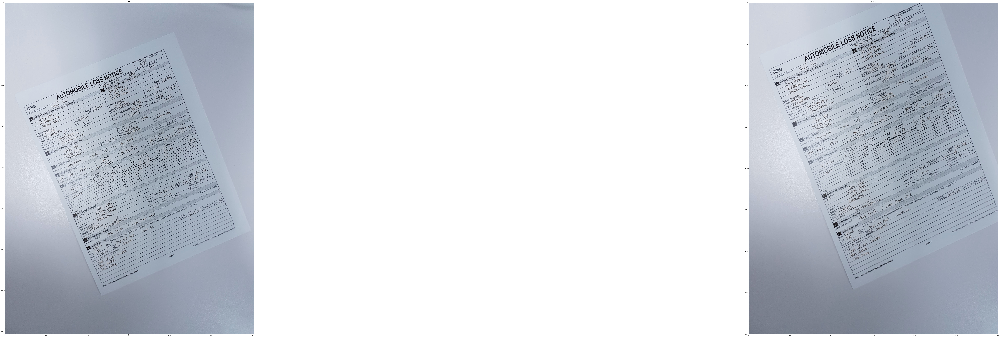

<Figure size 12960x11520 with 0 Axes>

In [49]:
indices = np.where(edges != [0])
minX = min(indices[1])
maxX = max(indices[1])
minY = min(indices[0])
maxY = max(indices[0])

print(minX,maxX,minY,maxY)
#img = cv2.imread('img1.jpg')
img = cv2.imread('2.jpg')

rows,cols,ch = img.shape


# Image 1 regular
#pts1= np.float32([[550,715], [2640,725],[0, 3775],[3024,3800]])
# Image 2 rotated right
pts1 = np.float32([[minX, minY],[maxX, minY], [minX,maxY],[maxX,maxY]])


pts2 = np.float32([[0,0],[3000,0],[0,4000],[3000,4000]])

M = cv2.getPerspectiveTransform(pts1, pts2)

dst = cv2.warpPerspective(img, M, (3000,4000))

plt.subplot(121),plt.imshow(img),plt.title('Input')
plt.subplot(122),plt.imshow(dst),plt.title('Output')

plt.rcParams['figure.figsize'] = [200, 50]
fig=plt.figure(figsize=(180, 160))

